In [147]:
] activate .

  Activating project at `/media/dasc3/SAMSUNG_SSD/dasc3/devansh/gatekeeper-exp-xavier/colcon_ws/src/process_bagfiles/julia_proc`


In [148]:
using HDF5

In [186]:
using Plots

In [187]:
close(fid)

In [375]:
using StaticArrays, Rotations
using NearestNeighbors

In [188]:
fname = "../pcls.h5"
fid = h5open(fname, "r")

🗂️ HDF5.File: (read-only) ../pcls.h5
├─ 📂 pcl
│  ├─ 📂 clean
│  │  ├─ 📂 certified
│  │  │  ├─ 🔢 1704906267637535136
│  │  │  ├─ 🔢 1704906267812550102
│  │  │  ├─ 🔢 1704906268012564812
│  │  │  ├─ 🔢 1704906268212550049
│  │  │  ├─ 🔢 1704906268412541782
│  │  │  ├─ 🔢 1704906268612542873
│  │  │  ├─ 🔢 1704906268812569106
│  │  │  ├─ 🔢 1704906269012528573
│  │  │  ├─ 🔢 1704906269212547613
│  │  │  ├─ 🔢 1704906269412520418
│  │  │  ├─ 🔢 1704906269612530868
│  │  │  ├─ 🔢 1704906269812523997
│  │  │  └─ (2336 more children)
│  │  └─ 📂 uncertified
│  │     ├─ 🔢 1704906267637535136
│  │     ├─ 🔢 1704906267812550102
│  │     ├─ 🔢 1704906268012564812
│  │     ├─ 🔢 1704906268212550049
│  │     ├─ 🔢 1704906268412541782
│  │     ├─ 🔢 1704906268612542873
│  │     ├─ 🔢 1704906268812569106
│  │     ├─ 🔢 1704906269012528573
│  │     ├─ 🔢 1704906269212547613
│  │     ├─ 🔢 1704906269412520418
│  │     ├─ 🔢 1704906269612530868
│  │     ├─ 🔢 1704906269812523997
│  │     └─ (2336 more children)
│  └─ 📂 noisy


In [412]:
obsColor(v) = v < 0.075 ? 0 : 1

function pcl_plot!(mat; cmap = palette([:black, :orange], 7), kwargs...)
    
    inds = [!isnan(v) for v in mat[:, 4] ]
    
    
    scatter!(
        mat[inds, 1], mat[inds, 2],
        marker_z = obsColor.(mat[inds, 4]),
        markers=:rect,
        markersize=1, markerstrokewidth=0,
        color=cmap
         ; kwargs...)
end

function get_pcl_label(clean=true, certified=false)
    label = "/pcl"
    if clean
        label *= "/clean"
    else
        label *= "/noisy"
    end
    if certified
        label *= "/certified"
    else
        label *= "/uncertified"
    end
    
    return label
end

function get_tf_label(clean=true, perturbed = false)
    label = "/tf"
    if clean
        label *= "/clean"
    else
        label *= "/noisy"
    end
    if perturbed
        label *= "/perturbed"
    else
        label *= "/true"
    end
    
    return label
end

function get_map_stamp(ind, clean=true, certified=false)
    
    label = get_pcl_label(clean, certified)
    
    g = fid[label]
    k = keys(g)
    
    st = parse(Int64, k[ind])
    
    return st
end

function get_map(ind, clean=true, certified=false)
    
    label = get_pcl_label(clean, certified)
    
    g = fid[label]
    k = keys(g)
    ds = g[k[ind]]
    
    return ds[]
    
end
    
    

function get_tf(stamp, clean=true, perturbed=false)
    
    label=get_tf_label(clean, perturbed)
    
    tf_mat = fid[label][]
    
    tf_st = tf_mat[:, 1]
    
    ind = findlast(x-> x <= stamp, tf_st)
    
    if isnothing(ind)
        error("isnothing!!")
    end
    
    row = tf_mat[ind, :]
    # 1. stamp
    # 2. x
    # 3. y
    # 4. z
    # 5. qw
    # 6. qx
    # 7. qy
    # 8. qz
    # 9. roll
    # 10. pitch
    # 11. yaw
    
    q = QuatRotation(row[5:8]...)
    t = row[2:4]
    
    H = [
        [RotMatrix(q);; t];
        [zeros(1, 3) ;; 1]
    ]
    
    return H
end

function rotate_map(map, H)

    pos = hcat(map[:, 1:3], ones(size(map, 1)))
    
    new_pos = pos * H' # = (H * (pos'))'
    
    return hcat(new_pos[:, 1:3], map[:, 4])
    
end
    
function obstacle_map(map)
    
    new_map = 1.0 * map
    new_map[:, 4] .= obsColor(map[:, 4])
    
    return new_map
end

function get_map_rotated(ind, clean, certified, perturbed)
    
    st = get_map_stamp(ind, clean, certified)
    
    m = get_map(ind, clean, certified)
    
    H = get_tf(st, clean, perturbed)
    
    return rotate_map(m, inv(H) )
end

function plot_fov!(x0=0.0, y0=0.0, yaw = 0.0, L=5.0, fov=π/2; kwargs...)
    x1 = x0 + L * cos(yaw + fov/2 )
    y1 = y0 + L * sin(yaw + fov/2 )   
    x2 = x0 + L * cos(yaw - fov/2 )
    y2 = y0 + L * sin(yaw - fov/2 )
    
    plot!([x0, x1, x2, x0], [y0, y1, y2, y0]; kwargs...)
end


function interpolate_map(map, pts; margin=0.075)
    map_pts = map[:, 1:3]'
    tree = KDTree(map_pts)
    
    inds, dists = nn(tree, pts')
    
    new_map = hcat(pts, map[inds, 4])
    
    bad_count = 0
    for i=1:size(new_map, 1)
        if dists[i] > margin
            new_map[i, 4] = NaN
            bad_count += 1
        end
    end
    
    @show bad_count 
    @show size(pts, 1)
    
    return new_map
end


interpolate_map (generic function with 1 method)

In [397]:
st = get_map_stamp(1000, false, true)

1704906467538257340

In [398]:
H = get_tf(st)

4×4 Matrix{Float64}:
 0.957805     -0.287419     0.000427364  -1.66346
 0.287418      0.957793    -0.00486158    0.0212084
 0.000987986   0.00477928   0.999988      1.10546
 0.0           0.0          0.0           1.0

In [399]:
map = get_map(1000, false, true)

10856×4 Matrix{Float32}:
 -4.125  -5.1    0.9  2.0
 -4.05   -5.1    0.9  2.0
 -3.975  -4.875  0.9  2.0
 -6.6    -2.7    0.9  0.129904
 -6.525  -2.7    0.9  0.183712
 -6.45   -2.7    0.9  0.183712
 -6.375  -2.7    0.9  0.167705
 -6.3    -2.7    0.9  0.15
 -6.225  -2.7    0.9  0.15
 -6.15   -2.7    0.9  0.212132
 -6.075  -2.7    0.9  0.212132
 -6.375  -2.625  0.9  0.106066
 -6.3    -2.625  0.9  0.075
  ⋮                   
 -2.7     6.0    0.9  0.933743
 -2.4     6.0    0.9  0.828402
 -2.325   6.0    0.9  0.804285
 -2.25    6.0    0.9  0.786607
 -2.175   6.0    0.9  0.786607
 -2.4     6.075  0.9  0.864942
 -2.325   6.075  0.9  0.841873
 -2.4     6.15   0.9  0.906228
  0.6     6.0    0.9  0.309233
  0.675   6.0    0.9  0.309233
  0.825   6.0    0.9  0.503115
 -0.975   6.3    0.9  0.786607

In [400]:
plot()
pcl_plot!(map)
plot!(xlims=(-8,8), ylims!(-8,8) )
plot!(title = st);

In [401]:
rot_map = rotate_map(map, H)

10856×4 Matrix{Float64}:
 -4.14818  -6.05351  1.977    2.0
 -4.07635  -6.03195  1.97708  2.0
 -4.06918  -5.79489  1.97823  2.0
 -7.20855  -4.46617  1.98603  0.129904
 -7.13672  -4.44461  1.9861   0.183712
 -7.06488  -4.42305  1.98618  0.183712
 -6.99305  -4.4015   1.98625  0.167705
 -6.92121  -4.37994  1.98632  0.15
 -6.84938  -4.35838  1.9864   0.15
 -6.77754  -4.33683  1.98647  0.212132
 -6.70571  -4.31527  1.98655  0.212132
 -7.01461  -4.32966  1.98661  0.106066
 -6.94277  -4.30811  1.98668  0.075
  ⋮                           
 -5.97366   4.98756  2.03146  0.933743
 -5.68632   5.07379  2.03176  0.828402
 -5.61449   5.09534  2.03183  0.804285
 -5.54265   5.1169   2.0319   0.786607
 -5.47082   5.13846  2.03198  0.786607
 -5.70788   5.14562  2.03211  0.864942
 -5.63604   5.16718  2.03219  0.841873
 -5.72943   5.21746  2.03247  0.906228
 -2.81291   5.93604  2.03472  0.309233
 -2.74107   5.9576   2.03479  0.309233
 -2.5974    6.00071  2.03494  0.503115
 -4.40768   5.7707   2.0346   0.78

In [402]:
@gif for ind = 1:2:40
    clean = false
    certified = true
    perturbed = true
    st = get_map_stamp(ind, clean, certified)
    plot()
    pcl_plot!(get_map_rotated(ind, clean, certified, perturbed); label=false )
    plot!(xlims=(-10, 10), ylims=(-10, 10) )
    plot!(title = st)
    plot_fov!(; label="true fov")
end;

[ Info: Saved animation to /media/dasc3/SAMSUNG_SSD/dasc3/devansh/gatekeeper-exp-xavier/colcon_ws/src/process_bagfiles/julia_proc/tmp.gif


In [403]:
ind = 2300
clean = true
certified = true
perturbed = false
map_gt = get_map_rotated(ind, clean, certified, perturbed)
map_ce = get_map_rotated(ind, false, true, true)

10058×4 Matrix{Float64}:
  0.227696      5.20484   -0.208678  -0.0
  0.165873      5.2473    -0.207916  -0.0
  0.104049      5.28975   -0.207154  -0.0
  0.0422261     5.33221   -0.206392  -0.0
  0.185236      5.14303   -0.209653  -0.0
  0.123413      5.18548   -0.20889   -0.0
  0.0615893     5.22794   -0.208128  -0.0
 -0.000234065   5.27039   -0.207366  -0.0
 -0.0620574     5.31284   -0.206604  -0.0
  0.142776      5.08121   -0.210627  -0.0
  0.0809524     5.12367   -0.209865  -0.0
  0.0191291     5.16612   -0.209103  -0.0
 -0.0426943     5.20857   -0.20834   -0.0
  ⋮                                  
 -3.94765      -3.39055   -0.345911   0.075
 -3.57436      -0.462835  -0.298095   2.0
 -3.18406      -0.821826  -0.304404   0.270416
 -3.22652      -0.883641  -0.305378   0.309233
 -3.28834      -0.841188  -0.304616   0.309233
 -3.26898      -0.945457  -0.306352   0.309233
 -3.3308       -0.903003  -0.30559    0.309233
 -3.99011      -3.45236   -0.346885  -0.0
 -4.36105      -3.19764   -0

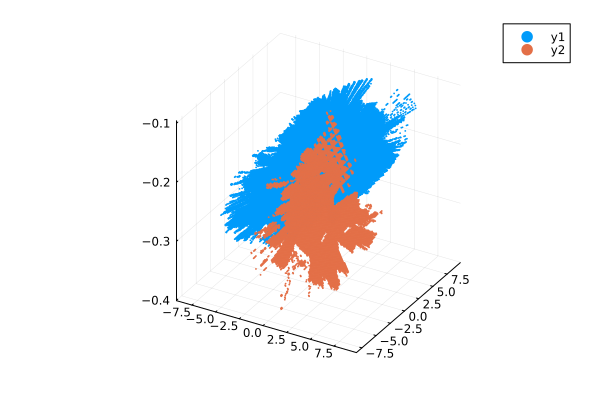

In [394]:
scatter(map_gt[:, 1], map_gt[:, 2], map_gt[:, 3], markersize=1, markerstrokewidth=0);
scatter!(map_ce[:, 1], map_ce[:, 2], map_ce[:, 3], markersize=1, markerstrokewidth=0)

In [404]:
p1 = plot()
pcl_plot!(map_gt; label=false )
p2 = plot()
pcl_plot!(map_ce; label=false )

p3 = plot(p1, p2, layout=(@layout [a b]));

In [405]:
GC.gc()

In [406]:
map_gt_projected_to_ce = interpolate_map(map_gt, map_ce[:, 1:3])

bad_count = 7188
size(pts, 1) = 10058


10058×4 Matrix{Float64}:
  0.227696      5.20484   -0.208678   -0.0
  0.165873      5.2473    -0.207916   -0.0
  0.104049      5.28975   -0.207154   -0.0
  0.0422261     5.33221   -0.206392    0.075
  0.185236      5.14303   -0.209653   -0.0
  0.123413      5.18548   -0.20889    -0.0
  0.0615893     5.22794   -0.208128   -0.0
 -0.000234065   5.27039   -0.207366   -0.0
 -0.0620574     5.31284   -0.206604   -0.0
  0.142776      5.08121   -0.210627   -0.0
  0.0809524     5.12367   -0.209865   -0.0
  0.0191291     5.16612   -0.209103    0.075
 -0.0426943     5.20857   -0.20834    -0.0
  ⋮                                  
 -3.94765      -3.39055   -0.345911  NaN
 -3.57436      -0.462835  -0.298095    0.318198
 -3.18406      -0.821826  -0.304404    0.225
 -3.22652      -0.883641  -0.305378    0.183712
 -3.28834      -0.841188  -0.304616    0.129904
 -3.26898      -0.945457  -0.306352    0.167705
 -3.3308       -0.903003  -0.30559     0.106066
 -3.99011      -3.45236   -0.346885  NaN
 -4.361

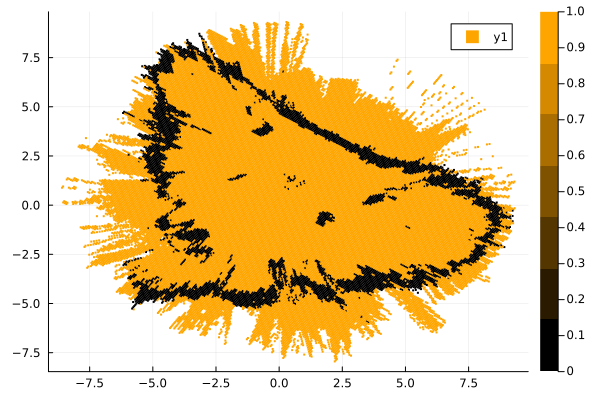

In [407]:
plot()
pcl_plot!(map_gt)

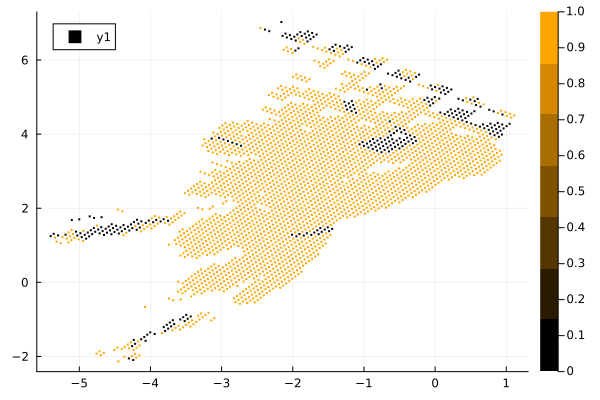

In [415]:
plot()
pcl_plot!(map_gt_projected_to_ce)

In [414]:
plot()
pcl_plot!(map_ce)

LoadError: MethodError: reducing over an empty collection is not allowed; consider supplying `init` to the reducer

In [413]:
map_ce_tmp = 1.0 * map_ce 
map_ce[:, 4] .= NaN

10058-element view(::Matrix{Float64}, :, 4) with eltype Float64:
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
   ⋮
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN